In [6]:


import h5py
import numpy as np
import pandas as pd

# Path to the HDF5 file
h5_file_path = "/mnt/disk15tb/paula/Main_DA_Projects/data_analysis_output/Primary Neurons/CDKL5_E6T1_Jun2025_jun26/ActivityScan_outputs/Compiled_Distributions.h5"  # Replace with the actual path to your HDF5 file


In [4]:
def print_h5_structure(name, obj):
    """Print the structure of the HDF5 file."""
    if isinstance(obj, h5py.Group):
        print(f"Group: {name}")
    elif isinstance(obj, h5py.Dataset):
        print(f"Dataset: {name}, Shape: {obj.shape}, Dtype: {obj.dtype}")

with h5py.File(h5_file_path, 'r') as h5file:
    h5file.visititems(print_h5_structure)

Dataset: Amplitude_uV, Shape: (26400, 234), Dtype: float64
Dataset: AssayType, Shape: (18, 234), Dtype: float64
Dataset: Chip_ID, Shape: (12, 234), Dtype: float64
Dataset: DIV, Shape: (1, 234), Dtype: float64
Dataset: FR_Hz, Shape: (26400, 234), Dtype: float64
Dataset: Fano, Shape: (26400, 234), Dtype: float64
Dataset: ISI_CV, Shape: (26400, 234), Dtype: float64
Dataset: ISI_STD, Shape: (26400, 234), Dtype: float64
Dataset: ISI_s, Shape: (26400, 234), Dtype: float64
Dataset: NeuronType, Shape: (1, 234), Dtype: float64
Dataset: Run_ID, Shape: (1, 234), Dtype: float64
Dataset: Well, Shape: (1, 234), Dtype: float64


In [ ]:
import h5py
import matplotlib.pyplot as plt
import numpy as np

# Path to the HDF5 file
h5_file_path = "/mnt/disk15tb/paula/Main_DA_Projects/data_analysis_output/Primary Neurons/CDKL5_E6T1_Jun2025_jun26/ActivityScan_outputs/Compiled_Distributions.h5"

# Open the HDF5 file
with h5py.File(h5_file_path, 'r') as h5file:
    # List of metadata fields to plot
    metadata_names = ['DIV', 'NeuronType', 'Run_ID', 'Well']
    
    for metadata_name in metadata_names :
        metadata = h5file[metadata_name][:]
        


        # Flatten the metadata if necessary
        if metadata.ndim > 1:
            metadata = metadata.flatten()
        
        # Plot the metadata
        plt.figure(figsize=(8, 6))
        
        if metadata_name in ['DIV', 'NeuronType', 'Run_ID', 'Well']:
            # Bar plot for categorical metadata
            unique_values, counts = np.unique(metadata, return_counts=True)
            plt.bar(unique_values, counts, color='skyblue', edgecolor='black')
            plt.xticks(unique_values, rotation=45)
            plt.title(f"Distribution of {metadata_name}")
            plt.xlabel(metadata_name)
            plt.ylabel("Count")
        else:
            # Histogram for numerical metadata
            plt.hist(metadata, bins=20, alpha=0.7, color='green', edgecolor='black')
            plt.title(f"Distribution of {metadata_name}")
            plt.xlabel(metadata_name)
            plt.ylabel("Frequency")
        
        plt.grid(True)
        plt.tight_layout()
        plt.show()

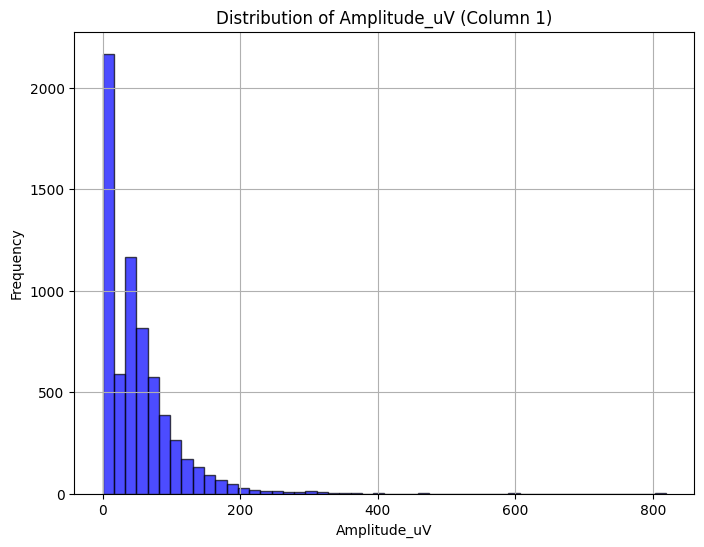

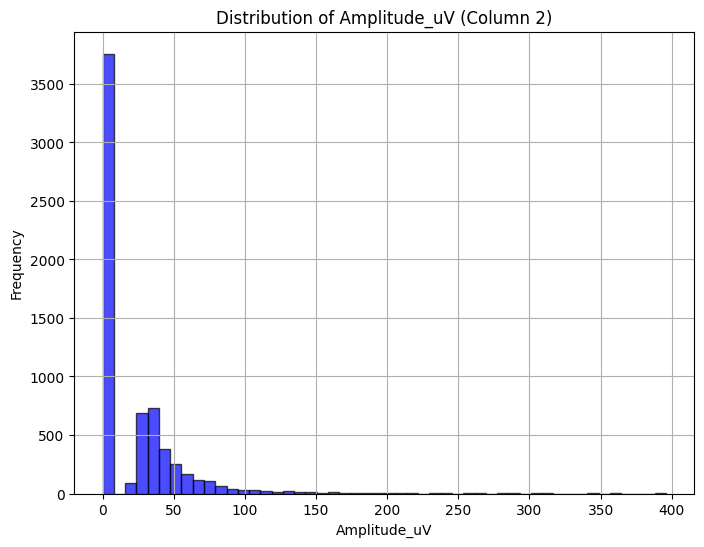

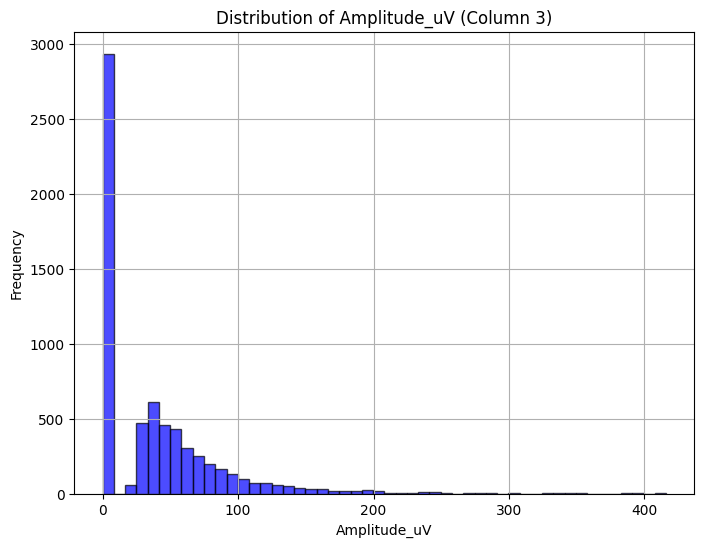

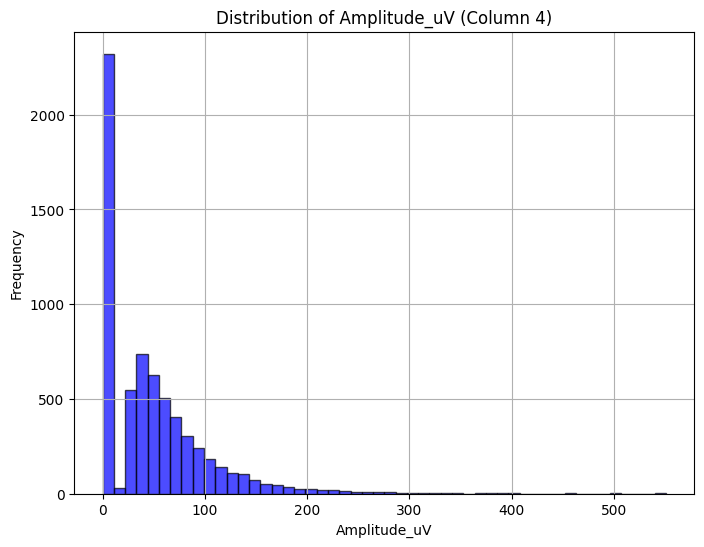

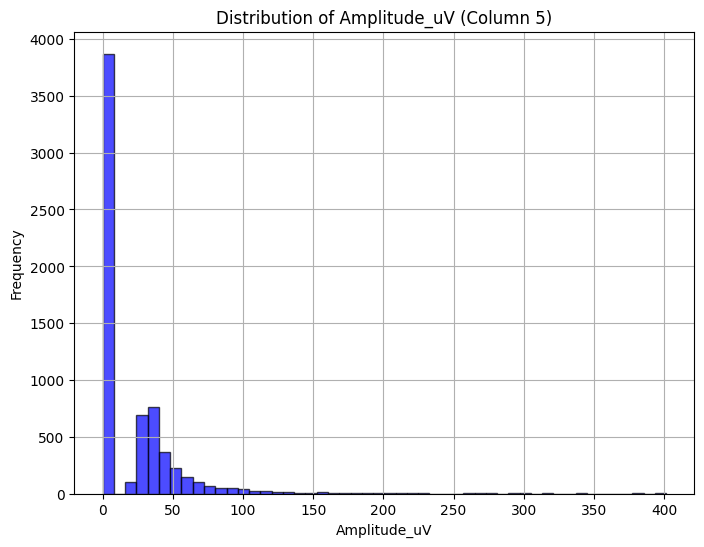

...

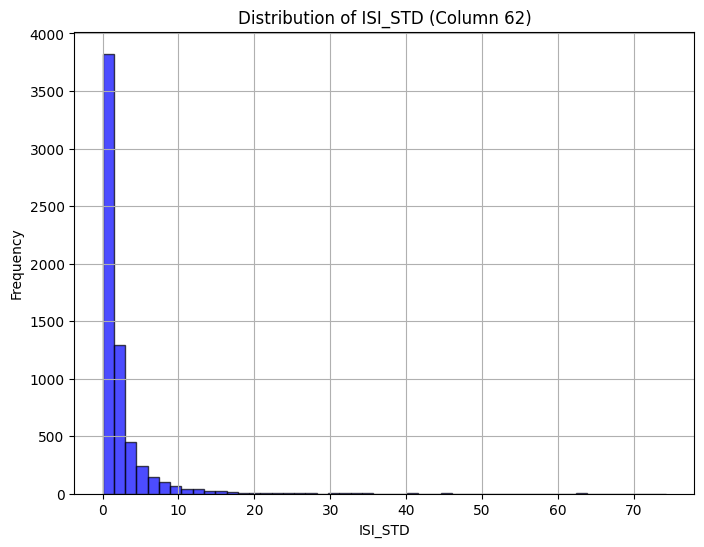

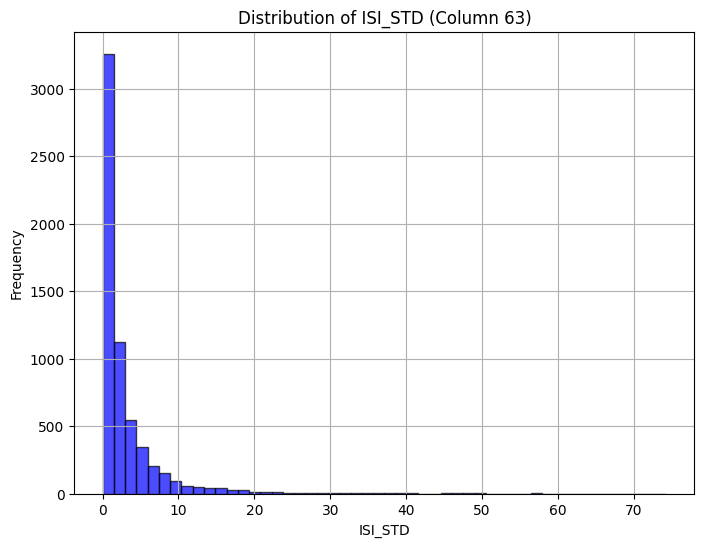

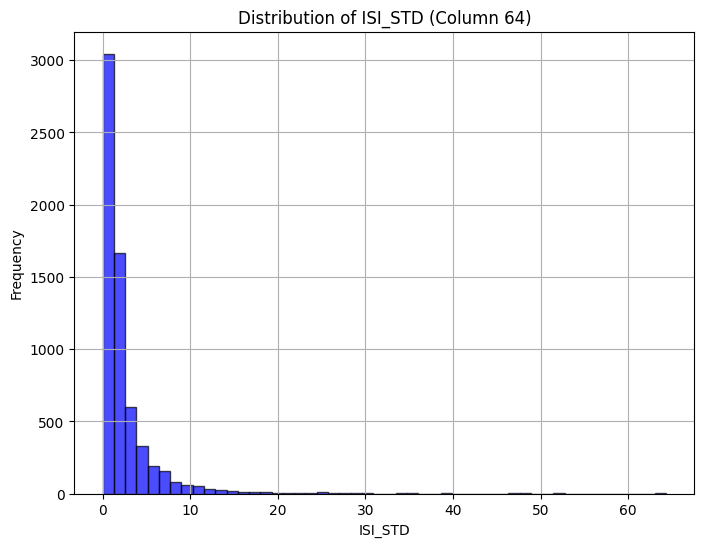

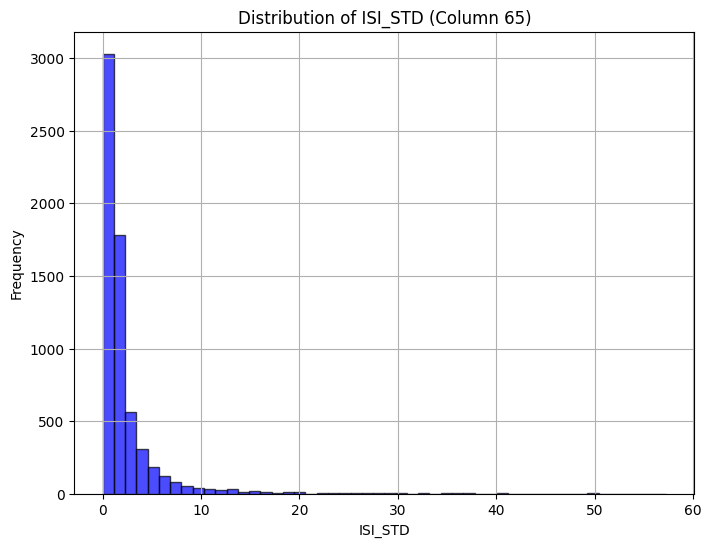

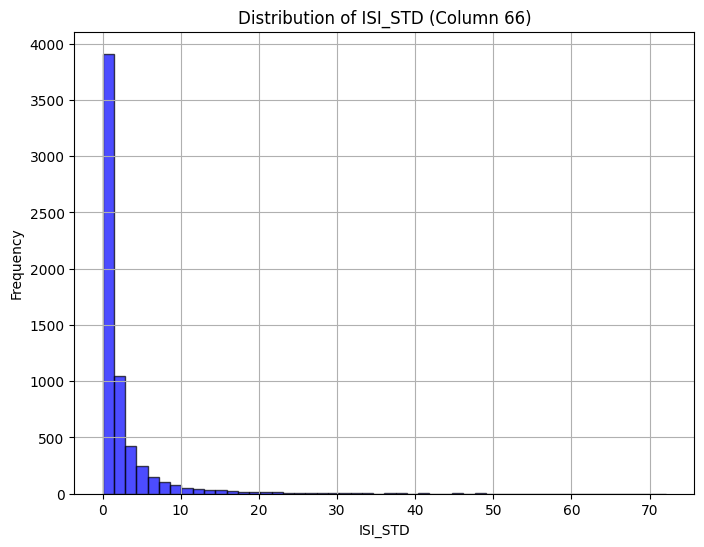

KeyboardInterrupt: 

In [8]:
import h5py
import matplotlib.pyplot as plt
import numpy as np

# Path to the HDF5 file
h5_file_path = "/mnt/disk15tb/paula/Main_DA_Projects/data_analysis_output/Primary Neurons/CDKL5_E6T1_Jun2025_jun26/ActivityScan_outputs/Compiled_Distributions.h5"

# Open the HDF5 file
with h5py.File(h5_file_path, 'r') as h5file:
    # List of datasets to plot
    datasets_to_plot = ['Amplitude_uV', 'FR_Hz', 'Fano', 'ISI_CV', 'ISI_STD', 'ISI_s']
    
    for dataset_name in datasets_to_plot:
        dataset = h5file[dataset_name]
        
        # Check if the dataset has shape (26400, 234)
        if dataset.shape[0] > 1:
            # Flatten the dataset along the first axis (26400) for each column (234)
            for i in range(dataset.shape[1]):  # Iterate over the 234 columns
                column_data = dataset[:, i]
                
                # Plot the distribution for the current column
                plt.figure(figsize=(8, 6))
                plt.hist(column_data, bins=50, alpha=0.7, color='blue', edgecolor='black')
                plt.title(f"Distribution of {dataset_name} (Column {i+1})")
                plt.xlabel(dataset_name)
                plt.ylabel("Frequency")
                plt.grid(True)
                plt.show()
        else:
            # For datasets with shape (1, 234), plot the values directly
            data = dataset.flatten()
            plt.figure(figsize=(8, 6))
            plt.hist(data, bins=50, alpha=0.7, color='green', edgecolor='black')
            plt.title(f"Distribution of {dataset_name}")
            plt.xlabel(dataset_name)
            plt.ylabel("Frequency")
            plt.grid(True)
            plt.show()

In [7]:

# Open the HDF5 file and extract data
with h5py.File(h5_file_path, 'r') as h5file:
    # Extract datasets into a dictionary
    data_dict = {
        "Amplitude_uV": h5file['Amplitude_uV'][:],
        "AssayType": h5file['AssayType'][:],
        "Chip_ID": h5file['Chip_ID'][:],
        "DIV": h5file['DIV'][:],
        "FR_Hz": h5file['FR_Hz'][:],
        "Fano": h5file['Fano'][:],
        "ISI_CV": h5file['ISI_CV'][:],
        "ISI_STD": h5file['ISI_STD'][:],
        "ISI_s": h5file['ISI_s'][:],
        "NeuronType": h5file['NeuronType'][:],
        "Run_ID": h5file['Run_ID'][:],
        "Well": h5file['Well'][:]
    }

# Convert the dictionary into a pandas DataFrame
# Transpose datasets with shape (1, 234) to align with other datasets
data_dict['DIV'] = data_dict['DIV'].flatten()
data_dict['NeuronType'] = data_dict['NeuronType'].flatten()
data_dict['Run_ID'] = data_dict['Run_ID'].flatten()
data_dict['Well'] = data_dict['Well'].flatten()

# Create a DataFrame
df = pd.DataFrame({
    "Amplitude_uV": data_dict['Amplitude_uV'].flatten(),
    "AssayType": np.tile(data_dict['AssayType'].flatten(), len(data_dict['Amplitude_uV']) // len(data_dict['AssayType'])),
    "Chip_ID": np.tile(data_dict['Chip_ID'].flatten(), len(data_dict['Amplitude_uV']) // len(data_dict['Chip_ID'])),
    "DIV": np.tile(data_dict['DIV'], len(data_dict['Amplitude_uV']) // len(data_dict['DIV'])),
    "FR_Hz": data_dict['FR_Hz'].flatten(),
    "Fano": data_dict['Fano'].flatten(),
    "ISI_CV": data_dict['ISI_CV'].flatten(),
    "ISI_STD": data_dict['ISI_STD'].flatten(),
    "ISI_s": data_dict['ISI_s'].flatten(),
    "NeuronType": np.tile(data_dict['NeuronType'], len(data_dict['Amplitude_uV']) // len(data_dict['NeuronType'])),
    "Run_ID": np.tile(data_dict['Run_ID'], len(data_dict['Amplitude_uV']) // len(data_dict['Run_ID'])),
    "Well": np.tile(data_dict['Well'], len(data_dict['Amplitude_uV']) // len(data_dict['Well']))
})

# Display the first few rows of the DataFrame
print(df.head())

ValueError: All arrays must be of the same length

In [ ]:

# Open the HDF5 file
with h5py.File(h5_file_path, 'r') as h5file:
    # Access the dataset containing allNestedDistributions
    all_records = np.squeeze(h5file['allNestedDistributions'])
    refined_results = []

    # Iterate through the records and extract the required fields
    for record in all_records:
        if record.size > 0:
            for item in record:
                if item.size > 0:
                    div = item[0][0][0]['DIV'][0][0]
                    well = item[0][0][0]['Well'][0][0]
                    run_id = item[0][0][0]['Run_ID'][0][0]
                    chip_id = item[0][0][0]['Chip_ID'][0]
                    firing_rate = item[0][0][0]['FR_Hz'][0]
                    amplitudes = item[0][0][0]['Amplitude_uV'][0]
                    isis = item[0][0][0]['ISI_s'][0]
                    fano_factor = item[0][0][0]['Fano'][0]

                    # Create a dictionary for the current entry
                    refined_entry = {
                        'Run_ID': run_id,
                        'Chip_ID': chip_id,
                        'DIV': div,
                        'WellRecord': well,
                        'FiringRate': firing_rate,
                        'Amplitudes': amplitudes,
                        'ISIs': isis,
                        'FanoFactor': fano_factor
                    }
                    refined_results.append(refined_entry)

# Convert the refined results into a pandas DataFrame for easier analysis
import pandas as pd
refined_df = pd.DataFrame(refined_results)

# Display the first few rows of the DataFrame
print(refined_df.head())

In [1]:
import scipy.io as sio
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
from scipy.interpolate import interp1d

In [2]:
activity_Data = sio.loadmat('/mnt/disk15tb/paula/Main_DA_Projects/data_analysis_output/Primary Neurons/CDKL5_E6T1_Jun2025/ActivityScan_outputs/Compiled_Distributions.mat')

In [9]:
print(activity_Data.keys())

dict_keys(['__header__', '__version__', '__globals__', 'None', '__function_workspace__'])


In [ ]:
filtered_data = {key: activity_Data[key] for key in activity_Data if key not in ['__header__', '__version__', '__globals__','__function_workspace__']}
print(filtered_data['None'

(1,)


In [ ]:
# Extract data and store in a dictionary
all_records = np.squeeze(filtered_data['allNestedDistributions'])
refined_results = []   
for record in all_records:
    if record.size > 0:
            for item in record:
                if item.size > 0:
                    div = item[0][0][0]['DIV'][0][0]
                    well = item[0][0][0]['Well'][0][0]
                    Run_ID = item[0][0][0]['Run_ID'][0][0]
                    Chip_ID = item[0][0][0]['Chip_ID'][0]
                    #NeuronType = item[0][0][0]['NeuronType'][0]
                    FiringRate = item[0][0][0]['FR_Hz'][0]
                    Amplitudes = item[0][0][0]['Amplitude_uV'][0]
                    ISIs = item[0][0][0]['ISI_s'][0]
                    #burstAPFreqEdges = item[0][0][0]['ISI_std'][0]
                    #nonburstAPFreqBins = item[0][0][0]['ISI_CV'][0]
                    FanoFactor = item[0][0][0]['Fano'][0]
                    refined_entry = {
                        'Run_ID': Run_ID,
                        'Chip_ID': Chip_ID,
                        'DIV': div,
                        'WellRecord': well,
                        #'NeuronType': NeuronType,
                        'FiringRate': FiringRate,
                        'Amplitudes': Amplitudes,
                        'ISIs': ISIs,
                        'FanoFactor': FanoFactor
                        #'nonburstAPFreqBins': nonburstAPFreqBins,
                        #'nonburstAPFreqEdges': nonburstAPFreqEdges
                    }
                    refined_results.append(refined_entry)

KeyError: 'allNestedDistributions'